In [ ]:
!git clone https://github.com/pjreddie/darknet


fatal: destination path 'darknet' already exists and is not an empty directory.


In [ ]:
!wget https://pjreddie.com/media/files/yolov3.weights


--2026-01-06 18:11:56--  https://pjreddie.com/media/files/yolov3.weights
Resolving pjreddie.com (pjreddie.com)... 172.67.185.199, 104.21.88.156, 2606:4700:3030::ac43:b9c7, ...
Connecting to pjreddie.com (pjreddie.com)|172.67.185.199|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://data.pjreddie.com/files/yolov3.weights [following]
--2026-01-06 18:11:56--  https://data.pjreddie.com/files/yolov3.weights
Resolving data.pjreddie.com (data.pjreddie.com)... 172.67.185.199, 104.21.88.156, 2606:4700:3037::6815:589c, ...
Connecting to data.pjreddie.com (data.pjreddie.com)|172.67.185.199|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 248007048 (237M) [application/octet-stream]
Saving to: ‘yolov3.weights.1’

yolov3.weights.1    100%[===================>] 236.52M  57.7MB/s    in 4.2s    

2026-01-06 18:12:00 (56.7 MB/s) - ‘yolov3.weights.1’ saved [248007048/248007048]



In [ ]:
%cd darknet
!make


[Errno 20] Not a directory: 'darknet'
/content/darknet
make: Nothing to be done for 'all'.


In [ ]:
!ls


0Train_via_annos.json  LICENSE.meta
0Val_via_annos.json    LICENSE.mit
backup		       LICENSE.v1
cfg		       Makefile
darknet		       obj
data		       python
examples	       README.md
image		       results
include		       scripts
libdarknet.a	       src
libdarknet.so	       validation
LICENSE		       vehide-dataset-automatic-vehicle-damage-detection.zip
LICENSE.fuck	       yolov3.weights
LICENSE.gen	       yolov3.weights.1
LICENSE.gpl


In [ ]:
!./darknet detect cfg/yolov3.cfg yolov3.weights data/dog.jpg


layer     filters    size              input                output
    0 conv     32  3 x 3 / 1   608 x 608 x   3   ->   608 x 608 x  32  0.639 BFLOPs
    1 conv     64  3 x 3 / 2   608 x 608 x  32   ->   304 x 304 x  64  3.407 BFLOPs
    2 conv     32  1 x 1 / 1   304 x 304 x  64   ->   304 x 304 x  32  0.379 BFLOPs
    3 conv     64  3 x 3 / 1   304 x 304 x  32   ->   304 x 304 x  64  3.407 BFLOPs
    4 res    1                 304 x 304 x  64   ->   304 x 304 x  64
    5 conv    128  3 x 3 / 2   304 x 304 x  64   ->   152 x 152 x 128  3.407 BFLOPs
    6 conv     64  1 x 1 / 1   152 x 152 x 128   ->   152 x 152 x  64  0.379 BFLOPs
    7 conv    128  3 x 3 / 1   152 x 152 x  64   ->   152 x 152 x 128  3.407 BFLOPs
    8 res    5                 152 x 152 x 128   ->   152 x 152 x 128
    9 conv     64  1 x 1 / 1   152 x 152 x 128   ->   152 x 152 x  64  0.379 BFLOPs
   10 conv    128  3 x 3 / 1   152 x 152 x  64   ->   152 x 152 x 128  3.407 BFLOPs
   11 res    8                 152 x 

In [ ]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt

print("Current Directory:", os.getcwd())


Current Directory: /content/darknet


In [ ]:
pip install kaggle


In [ ]:
from google.colab import files
files.upload()


Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"hellisrightinmyeyes","key":"d5dbcd9dc95b54a8b4c1a3054699735b"}'}

In [ ]:
!mkdir -p ~/.kaggle
!mv kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json


In [ ]:
!kaggle datasets download -d hendrichscullen/vehide-dataset-automatic-vehicle-damage-detection


Dataset URL: https://www.kaggle.com/datasets/hendrichscullen/vehide-dataset-automatic-vehicle-damage-detection
License(s): apache-2.0
 99% 2.08G/2.10G [00:25<00:00, 67.2MB/s]
100% 2.10G/2.10G [00:25<00:00, 88.1MB/s]


In [ ]:
!unzip vehide-dataset-automatic-vehicle-damage-detection.zip


Streaming output truncated to the last 5000 lines.
  inflating: image/image/22102020_091634image60207.jpg  
  inflating: image/image/22102020_091653image57537.jpg  
  inflating: image/image/22102020_091656image985485.jpg  
  inflating: image/image/22102020_092538image234088.jpg  
  inflating: image/image/22102020_092538image907615.jpg  
  inflating: image/image/22102020_092550image230529.jpg  
  inflating: image/image/22102020_095630image160624.jpg  
  inflating: image/image/22102020_095647image656381.jpg  
  inflating: image/image/22102020_095647image820454.jpg  
  inflating: image/image/22102020_095712image495296.jpg  
  inflating: image/image/22102020_095717image839663.jpg  
  inflating: image/image/22102020_095816image850173.jpg  
  inflating: image/image/22102020_100140image618831.jpg  
  inflating: image/image/22102020_102401image261580.jpg  
  inflating: image/image/22102020_102410image986649.jpg  
  inflating: image/image/22102020_102413image593513.jpg  
  inflating: image/imag

In [44]:
import glob

IMAGE_DIR = "/content/darknet/image/image"

all_image_paths = sorted(glob.glob(f"{IMAGE_DIR}/*.jpg"))

image_paths = all_image_paths[:300]

print(f"Using {len(image_paths)} images out of {len(all_image_paths)}")


Using 300 images out of 11621


(np.float64(-0.5), np.float64(799.5), np.float64(599.5), np.float64(-0.5))

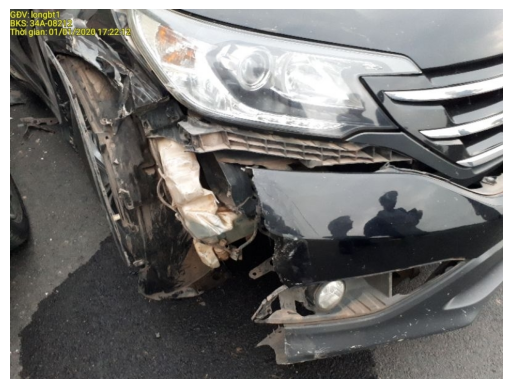

In [45]:
img = cv2.imread(image_paths[0])
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

plt.imshow(img_rgb)
plt.axis("off")


In [46]:
config_path = "cfg/yolov3.cfg"
weights_path = "yolov3.weights"

net = cv2.dnn.readNet(weights_path, config_path)

layer_names = net.getLayerNames()
output_layers = [layer_names[i - 1] for i in net.getUnconnectedOutLayers().flatten()]

print("Output layers:", output_layers)


Output layers: ['yolo_82', 'yolo_94', 'yolo_106']


In [47]:
def run_yolo(image):
    H, W = image.shape[:2]

    blob = cv2.dnn.blobFromImage(
        image, 1/255.0, (416, 416), swapRB=True, crop=False
    )

    net.setInput(blob)
    outputs = net.forward(output_layers)

    boxes = []
    confidences = []

    for output in outputs:
        for detection in output:
            confidence = detection[4]

            if confidence > 0.5:
                box = detection[0:4] * np.array([W, H, W, H])
                cx, cy, w, h = box.astype(int)

                x = int(cx - w / 2)
                y = int(cy - h / 2)

                boxes.append([x, y, w, h])
                confidences.append(float(confidence))

    return boxes, confidences


In [48]:
def draw_boxes(image, boxes, confidences):
    indices = cv2.dnn.NMSBoxes(boxes, confidences, 0.5, 0.4)

    if len(indices) == 0:
        return image

    # Handle different OpenCV return types safely
    if isinstance(indices, tuple):
        indices = indices[0]

    for i in indices:
        if isinstance(i, (list, tuple, np.ndarray)):
            i = i[0]

        x, y, w, h = boxes[i]
        conf = confidences[i]

        cv2.rectangle(image, (x, y), (x + w, y + h), (0, 255, 0), 2)
        cv2.putText(
            image,
            f"{conf:.2f}",
            (x, y - 5),
            cv2.FONT_HERSHEY_SIMPLEX,
            0.6,
            (0, 255, 0),
            2,
        )

    return image


(np.float64(-0.5), np.float64(799.5), np.float64(599.5), np.float64(-0.5))

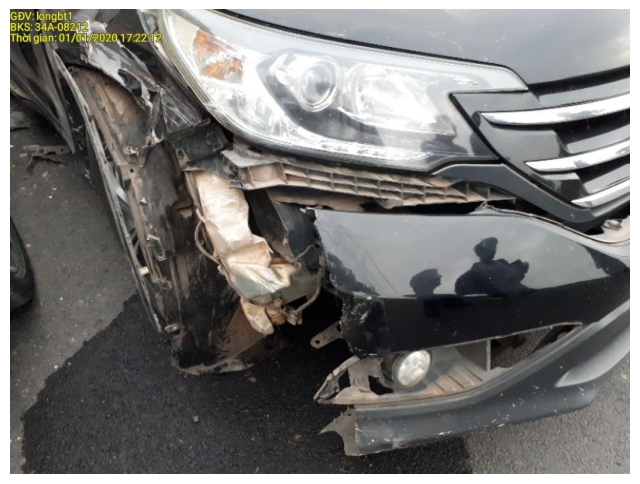

In [49]:
image = cv2.imread(image_paths[0])
boxes, confidences = run_yolo(image)

output_img = draw_boxes(image.copy(), boxes, confidences)

plt.figure(figsize=(8, 8))
plt.imshow(cv2.cvtColor(output_img, cv2.COLOR_BGR2RGB))
plt.axis("off")


/tmp/ipython-input-1326225875.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(6, 6))


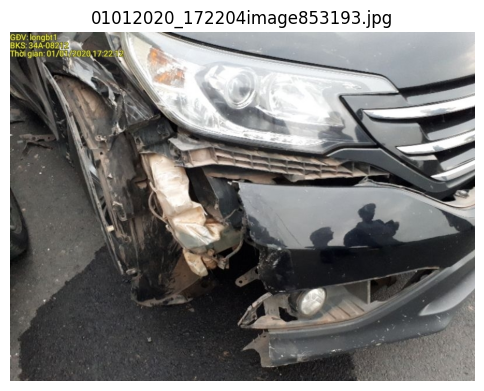

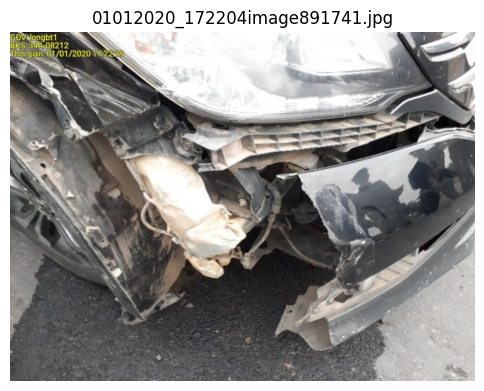

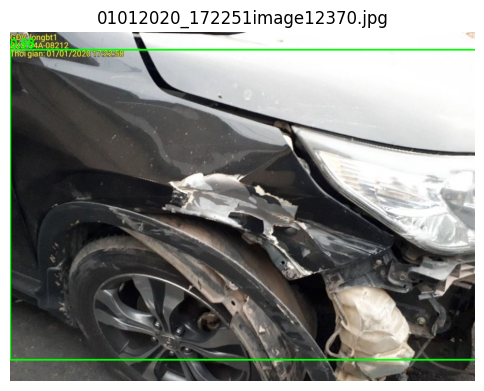

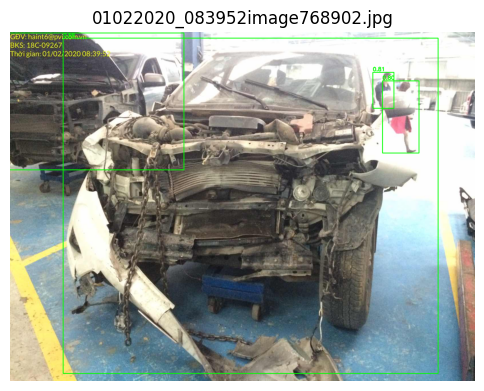

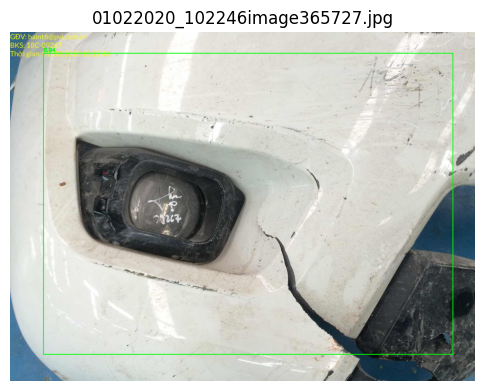

...

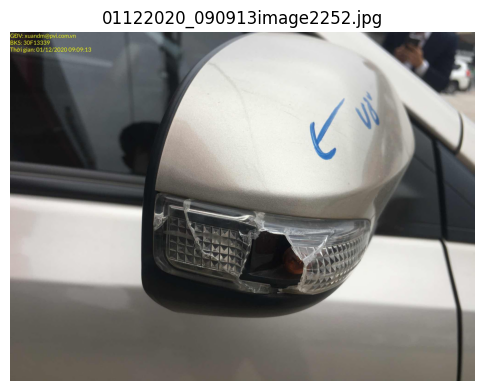

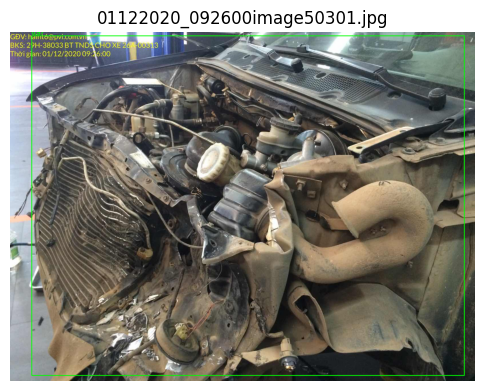

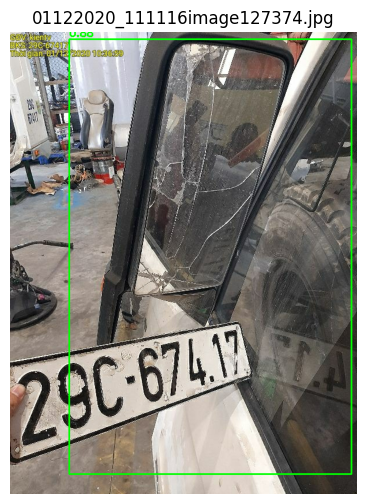

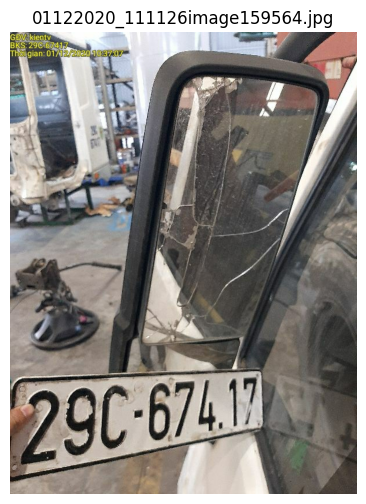

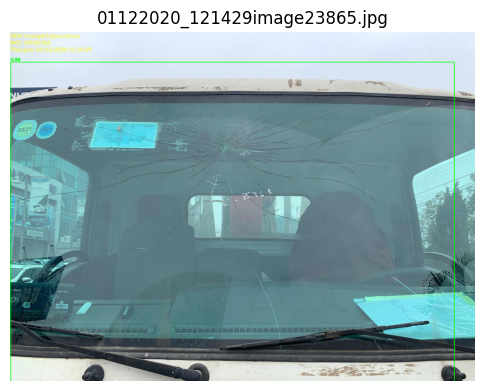

In [ ]:
for path in image_paths:
    img = cv2.imread(path)
    boxes, confidences = run_yolo(img)
    out = draw_boxes(img, boxes, confidences)

    plt.figure(figsize=(6, 6))
    plt.imshow(cv2.cvtColor(out, cv2.COLOR_BGR2RGB))
    plt.title(os.path.basename(path))
    plt.axis("off")


Step 6: Understanding the Predictions (YOLOv3)

YOLOv3 performs object detection by predicting bounding boxes directly from CNN feature maps.
Each prediction consists of:

Bounding box coordinates

Objectness (confidence) score

Class probabilities

Where YOLO Succeeds

YOLOv3 performs well in the following scenarios:

1. Large, Visually Distinct Damage

Big dents

Broken bumpers

Clearly visible scratches

Reason:
Large damage regions survive downsampling and remain visible even in low-resolution feature maps (13×13).

2. High Contrast Damage

Dark damage on light cars

Clear edge boundaries

Reason:
CNNs are strong at detecting edges, gradients, and contrast changes, which translate well into convolutional filters.

3. Well-Lit, Clean Images

Proper lighting

Minimal motion blur

Reason:
Noise-free images produce cleaner feature activations, improving bounding box confidence.

Where YOLO Fails

YOLOv3 struggles in the following cases:

1. Small Damage Regions

Hairline cracks

Tiny scratches

Reason:
Small objects disappear when feature maps are downsampled (especially at 13×13 and 26×26 scales).

2. Subtle Texture-Based Damage

Scratches of same color as the car

Minor paint variations

Reason:
YOLO is optimized for object-like patterns, not fine texture anomalies.

3. Occluded or Shadowed Damage

Damage hidden by reflections or shadows

Reason:
CNNs rely on visible spatial patterns; occlusion breaks continuity.

Understanding Confidence Scores

YOLO’s confidence score is:

Confidence
=
𝑃
(
object
)
×
𝑃
(
class
∣
object
)
Confidence=P(object)×P(class∣object)
High confidence means:

Strong objectness

High class probability

Good anchor match

Low confidence means:

Weak visual cues

Poor anchor fit

Ambiguous damage pattern

Missed Detections – Why They Occur

YOLO may miss damage because:

Damage size < anchor box scale

Feature map resolution too coarse

Low contrast between damage and background

Anchor shapes don’t match damage geometry

Reflection Questions
Why does YOLO need anchor boxes?

Answer:
Anchor boxes provide prior bounding box shapes that help the network predict boxes more accurately.

Without anchors:

The network must learn width and height from scratch

Box regression becomes unstable

With anchors:

Network predicts offsets relative to known shapes

Training and inference become more reliable

Why does multi-scale prediction help?

YOLOv3 predicts at three scales:

13×13 → large objects

26×26 → medium objects

52×52 → small objects

Answer:
Different damage sizes appear at different spatial resolutions.
Multi-scale prediction ensures:

Small damage survives at higher-resolution maps

Large damage is captured at lower-resolution maps

Why might YOLO fail on small or subtle damage?

Answer:
Because YOLO:

Downsamples images aggressively

Is optimized for object detection, not texture analysis

Uses anchors that favor larger, object-like regions

Small or subtle damage:

Produces weak activations

Blends into background feature maps

Falls below confidence thresholds

Final Key Insight

YOLO detects “objects”, not “anomalies”.
Vehicle damage often behaves like a texture anomaly, which is inherently harder for object detectors.

This is why:

Specialized damage detection models

Or segmentation-based approaches
often outperform YOLO for fine damage detection.